In [24]:
#import packages
import sdRDM
from sdRDM import DataModel
from sdRDM.database import build_sql_database

In [25]:
#import the data base
pyeed = DataModel.from_git("https://github.com/maxim945/PyEED-Fullprototype.git")
#visualize for each separate table
pyeed.ProteinSequence.visualize_tree()
pyeed.DNASequence.visualize_tree()
pyeed.Organism.visualize_tree()
pyeed.StandardNumberingScheme.visualize_tree()

ProteinSequence
├── id
├── protein_sequence_id
├── name
├── amino_acid_sequence
├── protein_database_name
│   └── ProteinDatabase
│       ├── id
│       ├── database
│       └── link_to_database
└── protein_organism_id
    └── Organism
        ├── id
        ├── organism_name
        └── ncbi_taxonomy_id
DNASequence
├── id
├── protein_sequence_id
│   └── ProteinSequence
│       ├── id
│       ├── protein_sequence_id
│       ├── name
│       ├── amino_acid_sequence
│       ├── protein_database_name
│       │   └── ProteinDatabase
│       │       ├── id
│       │       ├── database
│       │       └── link_to_database
│       └── protein_organism_id
│           └── Organism
│               ├── id
│               ├── organism_name
│               └── ncbi_taxonomy_id
├── dna_sequence_id
├── nucleotide_sequence
├── dna_database_id
│   └── DNADatabase
│       ├── id
│       ├── database
│       └── link_to_database
└── dna_organism_id
    └── Organism
        ├── id
        ├── organism_nam

In [26]:
#build the data base
build_sql_database(pyeed.ProteinSequence, loc="./Clusterclean.db")
build_sql_database(pyeed.DNASequence, loc="./Clusterclean.db")
build_sql_database(pyeed.Organism, loc="./Clusterclean.db")
build_sql_database(pyeed.StandardNumberingScheme, loc="./Clusterclean.db")


In [1]:
import pandas as pd
import sqlite3

# Connect to the database file
conn = sqlite3.connect("Cluster.db")

# Create a cursor object
cursor = conn.cursor()

# Execute a SELECT statement with specific columns
#cursor.execute("SELECT protein_sequence_id, amino_acid_sequence FROM ProteinSequence")
cursor.execute("SELECT protein_sequence_id, amino_acid_sequence,name FROM ProteinSequence")

# Fetch all rows from the result set
rows = cursor.fetchall()

# Get the column names from the cursor description
columns = [description[0] for description in cursor.description]

# Create a dataframe from the rows and columns
protdf = pd.DataFrame(rows, columns=columns)

# Print the dataframe
print(protdf)

# Close the cursor and connection
cursor.close()
conn.close()

/home/maxim/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:20: UserWarning: Pandas requires version '2.7.3' or newer of 'numexpr' (version '2.7.1' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


      protein_sequence_id                                amino_acid_sequence  \
0              QJE70211.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
1              QJE70210.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
2              QJE70209.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
3              QJE70208.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
4              QJE70207.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
...                   ...                                                ...   
24085          AGK07045.1                                               None   
24086          AGK07046.1                                               None   
24087          AGF34251.1                                               None   
24088          AGF34253.1                                               None   
24089          AGF34252.1                                               None   

        name  
0      TEM-1  
1      TE

In [2]:
import pandas as pd
from Bio import SeqIO

# create an empty DataFrame to store the matches
match_df = pd.DataFrame(columns=['amino_acid_sequence', 'name'])

# read in each FASTA file and select the matching rows
for name in ['TEM-1', 'TEM-109', 'TEM-33', 'TEM-3']:
    # read in the FASTA file
    fasta_sequences = SeqIO.parse(open(name), 'fasta')
    
    # extract the amino acid sequence from the FASTA record and select the matching rows
    for record in fasta_sequences:
        fasta_seq = str(record.seq)
        #print(fasta_seq)
        match_rows = protdf[protdf['amino_acid_sequence'] == fasta_seq]
        #print(match_rows)
        # add the matching rows to the match DataFrame
        if not match_rows.empty:
            match_rows['name'] = name
            match_df = pd.concat([match_df, match_rows], ignore_index=True)

# print the resulting DataFrame
print(match_df)

                                   amino_acid_sequence    name  \
0    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
1    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
2    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
3    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
4    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
..                                                 ...     ...   
107  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   
108  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   
109  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   
110  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   
111  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   

    protein_sequence_id  
0            QJE70211.1  
1            QJE70210.1  
2            QJE70209.1  
3            QJE70208.1  
4            QJE70207.1  
..                  ...  
107      WP_013279314.1  

<ipython-input-2-1237b0d217d8>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  match_rows['name'] = name
<ipython-input-2-1237b0d217d8>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  match_rows['name'] = name
<ipython-input-2-1237b0d217d8>:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#return

In [3]:
import sqlite3

# Connect to the database file
conn = sqlite3.connect("Cluster.db")

# Create a cursor object
cursor = conn.cursor()

# Execute a SELECT statement with specific columns
#cursor.execute("SELECT protein_sequence_id, amino_acid_sequence FROM ProteinSequence")
cursor.execute("SELECT protein_sequence_id_id, dna_sequence_id,nucleotide_sequence, dna_database_id_id, dna_organism_id_id FROM DNASequence")

# Fetch all rows from the result set
rows = cursor.fetchall()

# Get the column names from the cursor description
columns = [description[0] for description in cursor.description]

# Create a dataframe from the rows and columns
dnadf = pd.DataFrame(rows, columns=columns)

# Print the dataframe
print(dnadf)

# Close the cursor and connection
cursor.close()
conn.close()

      protein_sequence_id_id dna_sequence_id  \
0                 QJE70211.1        MT387486   
1                 QJE70210.1        MT387485   
2                 QJE70209.1        MT387484   
3                 QJE70208.1        MT387483   
4                 QJE70207.1        MT387482   
...                      ...             ...   
24085             AGK07045.1            None   
24086             AGK07046.1            None   
24087             AGF34251.1            None   
24088             AGF34253.1            None   
24089             AGF34252.1            None   

                                     nucleotide_sequence dna_database_id_id  \
0      ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...           GeneBank   
1      ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...           GeneBank   
2      ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...           GeneBank   
3      ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...           GeneBank   
4      ATGAGTATTCAACATTTTCGT

In [4]:
merdf = protdf.join(dnadf)

print(merdf)

      protein_sequence_id                                amino_acid_sequence  \
0              QJE70211.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
1              QJE70210.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
2              QJE70209.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
3              QJE70208.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
4              QJE70207.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
...                   ...                                                ...   
24085          AGK07045.1                                               None   
24086          AGK07046.1                                               None   
24087          AGF34251.1                                               None   
24088          AGF34253.1                                               None   
24089          AGF34252.1                                               None   

        name protein_sequence_id_id dna

In [5]:
import sqlite3

# Connect to the database file
conn = sqlite3.connect("Cluster.db")

# Create a cursor object
cursor = conn.cursor()

# Execute a SELECT statement with specific columns
#cursor.execute("SELECT protein_sequence_id, amino_acid_sequence FROM ProteinSequence")
cursor.execute("SELECT organism_name, ncbi_taxonomy_id FROM Organism")

# Fetch all rows from the result set
rows = cursor.fetchall()

# Get the column names from the cursor description
columns = [description[0] for description in cursor.description]

# Create a dataframe from the rows and columns
orgdf2 = pd.DataFrame(rows, columns=columns)

# Print the dataframe
print(orgdf2)

# Close the cursor and connection
cursor.close()
conn.close()

               organism_name ncbi_taxonomy_id
0           Escherichia coli              562
1           Escherichia coli              562
2           Escherichia coli              562
3           Escherichia coli              562
4           Escherichia coli              562
..                       ...              ...
395        Proteus mirabilis              584
396        Proteus mirabilis              584
397         Escherichia coli              562
398         Escherichia coli              562
399  Expression vector pSFV4          1292101

[400 rows x 2 columns]


In [6]:
fulldf = merdf.join(orgdf2)
print(fulldf)

      protein_sequence_id                                amino_acid_sequence  \
0              QJE70211.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
1              QJE70210.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
2              QJE70209.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
3              QJE70208.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
4              QJE70207.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
...                   ...                                                ...   
24085          AGK07045.1                                               None   
24086          AGK07046.1                                               None   
24087          AGF34251.1                                               None   
24088          AGF34253.1                                               None   
24089          AGF34252.1                                               None   

        name protein_sequence_id_id dna

In [7]:
#remove the exact duplicates from the original dataframe
cleaned_data = fulldf.drop_duplicates(subset='nucleotide_sequence', keep='first')

#reset index for the remaining sequences
cleaned_data = cleaned_data.reset_index(drop=True)

print(cleaned_data)

    protein_sequence_id                                amino_acid_sequence  \
0            QJE70211.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
1            QJE70200.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
2            QGC48744.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
3            QGB54447.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
4            QDG00224.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
..                  ...                                                ...   
179          QTF31193.1  ARVGYIELDLNSGKILESFRPEERFPMMSTFKVLLCGAVLSRVDAG...   
180          QTF31194.1  SVPLYAQTADVQQKLAELERQSGGRLGVALINTADNSQIL--YRAD...   
181          QTF31195.1  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...   
182          QTF31196.1  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...   
183          QTF31197.1  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...   

       name protein_sequence_id_id dna_sequence_id  \
0     TEM

In [8]:
orgdf2 = orgdf2.rename(columns={'ncbi_taxonomy_id': 'dna_organism_id_id'})
print(orgdf2)

               organism_name dna_organism_id_id
0           Escherichia coli                562
1           Escherichia coli                562
2           Escherichia coli                562
3           Escherichia coli                562
4           Escherichia coli                562
..                       ...                ...
395        Proteus mirabilis                584
396        Proteus mirabilis                584
397         Escherichia coli                562
398         Escherichia coli                562
399  Expression vector pSFV4            1292101

[400 rows x 2 columns]


In [9]:
match_df = cleaned_data[['protein_sequence_id', 'name', 'amino_acid_sequence', "dna_database_id_id",'dna_organism_id_id']]
#print(match_df)
match_df = match_df.rename(columns={'dna_database_id_id': 'protein_database_name_id'})
#print(match_df)
match_df = match_df.rename(columns={'dna_organism_id_id': 'protein_organism_id_id'})

print(match_df)

    protein_sequence_id    name  \
0            QJE70211.1   TEM-1   
1            QJE70200.1   TEM-1   
2            QGC48744.1   TEM-1   
3            QGB54447.1   TEM-1   
4            QDG00224.1   TEM-1   
..                  ...     ...   
179          QTF31193.1  TEM-33   
180          QTF31194.1  TEM-33   
181          QTF31195.1  TEM-33   
182          QTF31196.1  TEM-33   
183          QTF31197.1  TEM-33   

                                   amino_acid_sequence  \
0    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
1    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
2    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
3    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
4    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
..                                                 ...   
179  ARVGYIELDLNSGKILESFRPEERFPMMSTFKVLLCGAVLSRVDAG...   
180  SVPLYAQTADVQQKLAELERQSGGRLGVALINTADNSQIL--YRAD...   
181  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...   

In [ ]:
dnadf = cleaned_data[['protein_sequence_id', 'dna_sequence_id', 'nucleotide_sequence',"dna_database_id_id", 'dna_organism_id_id']]
#print(dnadf)
dnadf = dnadf.rename(columns={'protein_sequence_id': 'protein_sequence_id_id'})
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)
print(dnadf)


In [37]:
orgdf1 = cleaned_data
print(orgdf1)

    protein_sequence_id                                amino_acid_sequence  \
0            QJE70211.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
1            QJE70200.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
2            QGC48744.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
3            QGB54447.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
4            QDG00224.1  HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   
..                  ...                                                ...   
179          QTF31193.1  ARVGYIELDLNSGKILESFRPEERFPMMSTFKVLLCGAVLSRVDAG...   
180          QTF31194.1  SVPLYAQTADVQQKLAELERQSGGRLGVALINTADNSQIL--YRAD...   
181          QTF31195.1  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...   
182          QTF31196.1  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...   
183          QTF31197.1  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...   

       name protein_sequence_id_id dna_sequence_id  \
0     TEM

In [38]:

org_df = orgdf1[['organism_name', 'ncbi_taxonomy_id']]
print(org_df)

           organism_name ncbi_taxonomy_id
0       Escherichia coli              562
1       Escherichia coli              562
2       Escherichia coli              562
3    synthetic construct            32630
4       Escherichia coli              562
..                   ...              ...
179                  NaN              NaN
180                  NaN              NaN
181                  NaN              NaN
182                  NaN              NaN
183                  NaN              NaN

[184 rows x 2 columns]


In [39]:
import sqlite3

# Connecting to the database
connection = sqlite3.connect('Clusterclean.db')

# inserting all dataframes to a one merged dataframe on the same index
merged_df = pd.concat([match_df], axis=1)
#print(merged_df)
# Insert the dataframe into the database ProteinSequence table
merged_df.to_sql('ProteinSequence', connection, if_exists='append', index=False)

# Committing the changes
connection.commit()
 
# closing the database connection
connection.close()

In [22]:
import sqlite3

# Connecting to the database
connection = sqlite3.connect('Clusterclean.db')

# inserting all dataframes to a one merged dataframe on the same index
merged_df = pd.concat([dnadf], axis=1)
#print(merged_df)
# Insert the dataframe into the database ProteinSequence table
merged_df.to_sql('DNASequence', connection, if_exists='append', index=False)

# Committing the changes
connection.commit()
 
# closing the database connection
connection.close()

In [23]:
import sqlite3

# Connecting to the database
connection = sqlite3.connect('Clusterclean.db')

# inserting all dataframes to a one merged dataframe on the same index
merged_df = pd.concat([org_df], axis=1)
#print(merged_df)
# Insert the dataframe into the database ProteinSequence table
merged_df.to_sql('Organism', connection, if_exists='append', index=False)

# Committing the changes
connection.commit()
 
# closing the database connection
connection.close()

In [1]:
import pandas as pd
import sqlite3

# Connect to the database file
conn = sqlite3.connect("Clusterclean.db")

# Create a cursor object
cursor = conn.cursor()

# Execute a SELECT statement with specific columns
#cursor.execute("SELECT protein_sequence_id, amino_acid_sequence FROM ProteinSequence")
cursor.execute("SELECT amino_acid_sequence, name, protein_sequence_id FROM ProteinSequence")

# Fetch all rows from the result set
rows = cursor.fetchall()

# Get the column names from the cursor description
columns = [description[0] for description in cursor.description]

# Create a dataframe from the rows and columns
protdf = pd.DataFrame(rows, columns=columns)

# Print the dataframe
print(protdf)

# Close the cursor and connection
cursor.close()
conn.close()

/home/maxim/.local/lib/python3.8/site-packages/pandas/core/computation/expressions.py:20: UserWarning: Pandas requires version '2.7.3' or newer of 'numexpr' (version '2.7.1' currently installed).
  from pandas.core.computation.check import NUMEXPR_INSTALLED


                                   amino_acid_sequence    name  \
0    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
1    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
2    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
3    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
4    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
..                                                 ...     ...   
179  ARVGYIELDLNSGKILESFRPEERFPMMSTFKVLLCGAVLSRVDAG...  TEM-33   
180  SVPLYAQTADVQQKLAELERQSGGRLGVALINTADNSQIL--YRAD...  TEM-33   
181  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   
182  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   
183  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   

    protein_sequence_id  
0            QJE70211.1  
1            QJE70200.1  
2            QGC48744.1  
3            QGB54447.1  
4            QDG00224.1  
..                  ...  
179          QTF31193.1  

In [2]:
import pandas as pd
import sqlite3

# Connect to the database file
conn = sqlite3.connect("Clusterclean.db")

# Create a cursor object
cursor = conn.cursor()

# Execute a SELECT statement with specific columns
#cursor.execute("SELECT protein_sequence_id, amino_acid_sequence FROM ProteinSequence")
cursor.execute("SELECT nucleotide_sequence, dna_sequence_id FROM DNASequence")

# Fetch all rows from the result set
rows = cursor.fetchall()

# Get the column names from the cursor description
columns = [description[0] for description in cursor.description]

# Create a dataframe from the rows and columns
DNAdf = pd.DataFrame(rows, columns=columns)

# Print the dataframe
print(DNAdf)

# Close the cursor and connection
cursor.close()
conn.close()

                                   nucleotide_sequence dna_sequence_id
0    ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...        MT387486
1    ATGAGTATTCAACATTTCCGTGTCGCCCTTATTCCCTTTTTTGCGG...        MT387475
2    TTACCAATGCTTAATCAGTGAGGCACCTATCTCAGCGATCTGTCTA...        MN158355
3    ATGAGTATTCAACATTTCCGTGTCGCCCTTATTCCCTTTTTTGCGG...        MN045293
4    ATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGGCATTTT...        MN096661
..                                                 ...             ...
179  CTCTTTATGGTTGATAGTACCACCACCGAGGCGACGACACCGGAAG...        JX121641
180  CTCTTTATGGTTGATAGTACCACCACCGAGGCGACGACACCGGAAG...        JX121640
181  ATGAATCAATCATTTATCTCCGATATTCTTTACGCAGACATTGAAA...        LR999867
182  ATGAATCAATCATTTATCTCCGATATTCTTTACGCAGACATTGAAA...        LR999865
183  GCAACCATAGTACGCGCCCTGTAGCGGCGCATTAAGCGCGGCGGGT...        KC164372

[184 rows x 2 columns]


In [3]:
DNAPROTdf = protdf.join(DNAdf)


DNAPROTdf = DNAPROTdf[DNAPROTdf['protein_sequence_id'] != 'QGC48744.1']

DNAPROTdf.dropna(subset=['nucleotide_sequence', 'name'], inplace=True)

print(DNAPROTdf)

                                   amino_acid_sequence    name  \
0    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
1    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
3    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
4    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
5    HPETLVKVKDAEDQLGARVGYIELDLNSGKILESFRPEERFPMMST...   TEM-1   
..                                                 ...     ...   
179  ARVGYIELDLNSGKILESFRPEERFPMMSTFKVLLCGAVLSRVDAG...  TEM-33   
180  SVPLYAQTADVQQKLAELERQSGGRLGVALINTADNSQIL--YRAD...  TEM-33   
181  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   
182  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   
183  MSIQHFRVALIPFFAAFCLPVFAHPETLVKVKDAEDQLGARVGYIE...  TEM-33   

    protein_sequence_id                                nucleotide_sequence  \
0            QJE70211.1  ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...   
1            QJE70200.1  ATGAGTATTCAACATTTCCGTGTCGC

In [ ]:
from Bio import SeqIO
from Bio import pairwise2
from Bio.Seq import reverse_complement
from Bio.pairwise2 import format_alignment
from concurrent.futures import ThreadPoolExecutor
import pandas as pd

# Read the reference sequence
seq1 = "ATGAGTATTCAACATTTCCGTGTCGCCCTTATTCCCTTTTTTGCGGCATTTTGCCTTCCTGTTTTTGCTCACCCAGAAACGCTGGTGAAAGTAAAAGATGCTGAAGATCAGTTGGGTGCACGAGTGGGTTACATCGAACTGGATCTCAACAGCGGTAAGATCCTTGAGAGTTTTCGCCCCGAAGAACGTTTTCCAATGATGAGCACTTTTAAAGTTCTGCTATGTGGTGCGGTATTATCCCGTGTTGACGCCGGGCAAGAGCAACTCGGTCGCCGCATACACTATTCTCAGAATGACTTGGTTGAGTACTCACCAGTCACAGAAAAGCATCTTACGGATGGCATGACAGTAAGAGAATTATGCAGTGCTGCCATAACCATGAGTGATAACACTGCTGCCAACTTACTTCTGACAACGATCGGAGGACCGAAGGAGCTAACCGCTTTTTTGCACAACATGGGGGATCATGTAACTCGCCTTGATCGTTGGGAACCGGAGCTGAATGAAGCCATACCAAACGACGAGCGTGACACCACGATGCCTGCAGCAATGGCAACAACGTTGCGCAAACTATTAACTGGCGAACTACTTACTCTAGCTTCCCGGCAACAATTAATAGACTGGATGGAGGCGGATAAAGTTGCAGGACCACTTCTGCGCTCGGCCCTTCCGGCTGGCTGGTTTATTGCTGATAAATCTGGAGCCGGTGAGCGTGGGTCTCGCGGTATCATTGCAGCACTGGGGCCAGATGGTAAGCCCTCCCGTATCGTAGTTATCTACACGACGGGGAGTCAGGCAACTATGGATGAACGAAATAGACAGATCGCTGAGATAGGTGCCTCACTGATTAAGCATTGG"

# Read the sequences from the dataframe
seq_records = []
for index, row in DNAPROTdf.iterrows():
    seq_record = SeqIO.SeqRecord(seq=row["nucleotide_sequence"], id=row["protein_sequence_id"])
    seq_records.append(seq_record)

# Define the alignment function
def perform_alignment(seq_record):
    seq_record.annotations["alignment"] = None
    seq_record.annotations["is_reverse"] = False

    seq2 = seq_record.seq
    seq2_rc = reverse_complement(seq2)

    # Perform alignment of the original sequence
    alignments = pairwise2.align.globalms(seq1, seq2, 1, -1, -10, -0.1)

    # Perform alignment of the reverse complement sequence
    alignments_rc = pairwise2.align.globalms(seq1, seq2_rc, 1, -1, -10, -0.1)

    # Determine which alignment has the highest score
    best_alignment = max(alignments, key=lambda x: x.score)
    best_alignment_rc = max(alignments_rc, key=lambda x: x.score)

    # Check if the reverse complement had a higher score
    is_reverse = (best_alignment_rc.score > best_alignment.score)
    
    # Return the result
    if is_reverse:
        return (seq_record.id, True)
    else:
        return (seq_record.id, False)

dbreverse = pd.DataFrame(columns=["protein_sequence_id", "TorF"])

with ThreadPoolExecutor() as executor:
    results = executor.map(perform_alignment, seq_records)
    for result in results:
        protein_sequence_id, is_reverse = result
        print(protein_sequence_id + " " + str(is_reverse))
        dbreverse = pd.concat([dbreverse, pd.DataFrame({"protein_sequence_id": [protein_sequence_id], "TorF": [is_reverse]})], ignore_index=True)
        dbreverse["TorF"] = dbreverse["TorF"].astype(bool)


QJE70211.1 False
QJE70200.1 False
QGC48744.1 True
QGB54447.1 False
QDG00224.1 False
AWK68069.1 False
AWK68068.1 False
AWK68067.1 False
AWK68065.1 False
AWG43868.1 False
AVE14256.1 False
AHN62079.1 False
AHN62076.1 False
QWY17574.1 False
AAZ23494.1 False
ARF31821.1 False
ARF31804.1 False
ARF31801.1 False
ARF31791.1 False
ARF31781.1 False
ARF31743.1 False
ARF31734.1 False


In [ ]:
from Bio import SeqIO
from Bio import pairwise2
from Bio.Seq import reverse_complement
from Bio.pairwise2 import format_alignment

# Read the reference sequence
seq1 = "ATGAGTATTCAACATTTCCGTGTCGCCCTTATTCCCTTTTTTGCGGCATTTTGCCTTCCTGTTTTTGCTCACCCAGAAACGCTGGTGAAAGTAAAAGATGCTGAAGATCAGTTGGGTGCACGAGTGGGTTACATCGAACTGGATCTCAACAGCGGTAAGATCCTTGAGAGTTTTCGCCCCGAAGAACGTTTTCCAATGATGAGCACTTTTAAAGTTCTGCTATGTGGTGCGGTATTATCCCGTGTTGACGCCGGGCAAGAGCAACTCGGTCGCCGCATACACTATTCTCAGAATGACTTGGTTGAGTACTCACCAGTCACAGAAAAGCATCTTACGGATGGCATGACAGTAAGAGAATTATGCAGTGCTGCCATAACCATGAGTGATAACACTGCTGCCAACTTACTTCTGACAACGATCGGAGGACCGAAGGAGCTAACCGCTTTTTTGCACAACATGGGGGATCATGTAACTCGCCTTGATCGTTGGGAACCGGAGCTGAATGAAGCCATACCAAACGACGAGCGTGACACCACGATGCCTGCAGCAATGGCAACAACGTTGCGCAAACTATTAACTGGCGAACTACTTACTCTAGCTTCCCGGCAACAATTAATAGACTGGATGGAGGCGGATAAAGTTGCAGGACCACTTCTGCGCTCGGCCCTTCCGGCTGGCTGGTTTATTGCTGATAAATCTGGAGCCGGTGAGCGTGGGTCTCGCGGTATCATTGCAGCACTGGGGCCAGATGGTAAGCCCTCCCGTATCGTAGTTATCTACACGACGGGGAGTCAGGCAACTATGGATGAACGAAATAGACAGATCGCTGAGATAGGTGCCTCACTGATTAAGCATTGG"

# Read the sequences from the dataframe
seq_records = []
for index, row in DNAPROTdf.iterrows():
    seq_record = SeqIO.SeqRecord(seq=row["nucleotide_sequence"], id=row["protein_sequence_id"])
    seq_records.append(seq_record)

# Perform the pairwise alignments
dbreverse = pd.DataFrame(columns=["protein_sequence_id", "TorF"])
for seq_record in seq_records:
    seq_record.annotations["alignment"] = None
    seq_record.annotations["is_reverse"] = False
    
    seq2 = seq_record.seq
    seq2_rc = reverse_complement(seq2)
    
    # Perform alignment of the original sequence
    alignments = pairwise2.align.globalms(seq1, seq2, 1, -1, -10, -0.1)
    
    # Perform alignment of the reverse complement sequence
    alignments_rc = pairwise2.align.globalms(seq1, seq2_rc, 1, -1, -10, -0.1)
    
    # Determine which alignment has the highest score
    best_alignment = max(alignments, key=lambda x: x.score)
    best_alignment_rc = max(alignments_rc, key=lambda x: x.score)
    
    # Check if the reverse complement had a higher score
    is_reverse = (best_alignment_rc.score > best_alignment.score)
    
    # Print the result
    if is_reverse:
        print(seq_record.id + " True")
        dbreverse = pd.concat([dbreverse, pd.DataFrame({"protein_sequence_id": [seq_record.id], "TorF": [True]})], ignore_index=True)
        dbreverse["TorF"] = dbreverse["TorF"].astype(bool)
    else:
        print(seq_record.id + " False")
        dbreverse = pd.concat([dbreverse, pd.DataFrame({"protein_sequence_id": [seq_record.id], "TorF": [False]})], ignore_index=True)
        dbreverse["TorF"] = dbreverse["TorF"].astype(bool)
        

In [ ]:
print(dbreverse)

In [24]:
import pandas as pd

reversed_df = pd.merge(dbreverse, DNAPROTdf, on='protein_sequence_id')

In [25]:
# create a dictionary to map each nucleotide to its complement
complement = {'A': 'T', 'C': 'G', 'G': 'C', 'T': 'A'}

# filter the rows where TorF is True
true_rows = reversed_df[reversed_df['TorF'] == True]

# reverse and complement the nucleotide_sequence in these rows
reversed_complemented_seqs = true_rows['nucleotide_sequence'].apply(lambda x: ''.join(complement.get(base, base) for base in x[::-1]))

# update the original DataFrame with the reversed and complemented sequences
reversed_df.loc[true_rows.index, 'nucleotide_sequence'] = reversed_complemented_seqs

print(reversed_df)
reversed_df.to_csv('reversed_complemented_seqs.csv', index=False)

   protein_sequence_id   TorF  \
0           QGC48744.1   True   
1           QGB54447.1  False   
2           QDG00224.1  False   
3           AWK68069.1  False   
4           AWK68068.1  False   
5           AWK68067.1  False   
6           AWK68065.1  False   
7           AWG43868.1  False   
8           AVE14256.1  False   
9           UZG89780.1  False   
10          UUT29267.1  False   
11          AHN62079.1  False   
12          AHN62076.1  False   
13      WP_063864949.1  False   
14      WP_063864799.1  False   
15          AAT46413.1  False   
16          CAA41038.1  False   
17          ARF32105.1  False   
18      WP_063864870.1  False   
19      WP_032490103.1  False   
20          ANG25837.1  False   
21          ANG15993.1  False   
22          ANG13268.1  False   
23          CAC43180.1  False   
24          CAA76796.1  False   
25          CAA46346.1  False   
26      WP_063864912.1  False   
27          ARF31046.1  False   
28          ARF30576.1  False   
29        

In [5]:
data_df = DNAPROTdf[['protein_sequence_id','name', 'dna_sequence_id']]
print(data_df)

    protein_sequence_id    name dna_sequence_id
0            QJE70211.1   TEM-1        MT387486
1            QJE70200.1   TEM-1        MT387475
3            QGB54447.1   TEM-1        MN045293
4            QDG00224.1   TEM-1        MN096661
5            AWK68069.1   TEM-1        MF370950
..                  ...     ...             ...
179          QTF31193.1  TEM-33        JX121641
180          QTF31194.1  TEM-33        JX121640
181          QTF31195.1  TEM-33        LR999867
182          QTF31196.1  TEM-33        LR999865
183          QTF31197.1  TEM-33        KC164372

[182 rows x 3 columns]


In [ ]:
from Bio.Align.Applications import ClustalwCommandline
from Bio import AlignIO
import pandas as pd



# Run Clustal to align the sequences in the FASTA file
clustalw_cline = ClustalwCommandline("clustalw", infile="sequences_DNA.fasta")
stdout, stderr = clustalw_cline()

# Read the alignment from the Clustalw output file
alignment = AlignIO.read("sequences_DNA.aln", "clustal")

# Print the alignment
print(alignment)

AlignIO.write(alignment, "alignmentcombined.sto", "stockholm")

In [93]:
import pyhmmer
from Bio import SeqIO
from Bio import AlignIO
pyhmmer.__version__

align = AlignIO.read("alignmentcombined.sto", "stockholm")
print(align)

Alignment with 18 rows and 1189 columns
--------------------------------------------...--- AWK68068.1
--------------------------------------------...--- AVE14256.1
--------------------------------------------...--- AWK68065.1
--------------------------------------------...--- UUT29267.1
--------------------------------------------...--- AWK68069.1
--------------------------------------------...--- AWK68067.1
--------------------------------------------...--- QGB54447.1
--------------------------------------------...--- UZG89780.1
--------------------------------------------...--- QDG00224.1
--------------------------------------------...TGA WP_013279314.1
--------------------------------------------...--- AHN62079.1
--------------------------------------------...--- AHN62076.1
--------------------------------------------...--- QWY17510.1
--------------------------------------------...--- AWG43868.1
--------------------------------------------...--- ANG24641.1
--------------------------

In [94]:
alphabet = pyhmmer.easel.Alphabet.dna()


In [97]:
with pyhmmer.easel.MSAFile("alignmentcombined.sto", digital=True, alphabet=alphabet) as msa_file:
    msa = msa_file.read()
    print(msa)

In [98]:
builder = pyhmmer.plan7.Builder(alphabet)
background = pyhmmer.plan7.Background(alphabet)
hmm, _, _ = builder.build_msa(msa, background)

In [99]:
with open("Profile_HMM.hmm", "wb") as output_file:
    hmm.write(output_file)

In [20]:
with open('sequence_reference.fasta', 'w') as f:
    row = merged_dna_prot_df.iloc[3] # get the fourth row (index 3)
    dna_seq = row['nucleotide_sequence']
    prot_id = row['protein_sequence_id']
    f.write(f'>{prot_id}\n{dna_seq}\n')

In [21]:
import subprocess

# Run HMMER to search for hits in your sequence
hmmsearch_cmd = ['hmmsearch', '-E', '0.01', '--domE', '0.01', '-o', 'TEM-1_reference.txt', 'HMM_profile.hmm',
                 'sequence_reference.fasta']
print(subprocess.run(hmmsearch_cmd, check=True))

# Read in the output file and print it out
with open('TEM-1_reference.txt', 'r') as f:
    print(f.read())
    
    

CompletedProcess(args=['hmmsearch', '-E', '0.01', '--domE', '0.01', '-o', 'TEM-1_reference.txt', 'HMM_profile.hmm', 'sequence_reference.fasta'], returncode=0)
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  HMM_profile.hmm
# target sequence database:        sequence_reference.fasta
# output directed to file:         TEM-1_reference.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       HMM_profile  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N

In [115]:
from modules.number_extractor import extract_profile_hmm

input_file = './TEM-1_reference.txt'
output_file = './nucleotide_number.csv'
prefix_str = "HMM_profile"

df = extract_profile_hmm(input_file, output_file, prefix_str)
print(df)

     amino_acid_number Profile_HMM
0                    1           A
1                    2           T
2                    3           G
3                    4           A
4                    5           G
..                 ...         ...
853                854           A
854                855           T
855                856           T
856                857           G
857                858           G

[858 rows x 2 columns]


In [5]:
import tempfile
import subprocess

for index, row in data_df.iterrows():
    # create a temporary file for the sequence in FASTA format
    with tempfile.NamedTemporaryFile(mode='w', delete=False) as tmpfile:
        tmpfile.write(f'>seq{index}\n{row["nucleotide_sequence"]}\n')
        tmpfile.flush()

        # run hmmsearch on the temporary file
        hmmsearch_cmd = ['hmmsearch', '-E', '0.01', '--domE', '0.01', '-o',
                         f'./Documents/TEM-sequences_{index}.txt',
                         './Profile_HMM.hmm', tmpfile.name]
        result = subprocess.run(hmmsearch_cmd, capture_output=True)
        print("stdout:", result.stdout.decode())
        print("stderr:", result.stderr.decode())

    # print the output file
    with open(f'./Documents/TEM-sequences_{index}.txt', 'r') as f:
        print(f.read())

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp7meuqa4u
# output directed to file:         ./Documents/TEM-sequences_0.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1042.4   0.0       

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmppadacik1
# output directed to file:         ./Documents/TEM-sequences_4.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1035.2   0.0       

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpajhh7ruw
# output directed to file:         ./Documents/TEM-sequences_6.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1042.4   0.0       

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpydnxdeap
# output directed to file:         ./Documents/TEM-sequences_9.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1039.5   0.0       

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpp3de4658
# output directed to file:         ./Documents/TEM-sequences_12.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1027.5   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp_sj0m_sp
# output directed to file:         ./Documents/TEM-sequences_14.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1024.9   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp61sg491u
# output directed to file:         ./Documents/TEM-sequences_17.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1030.9   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpy3zz433n
# output directed to file:         ./Documents/TEM-sequences_21.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1031.8   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpebml8syd
# output directed to file:         ./Documents/TEM-sequences_23.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1034.4   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmprac2rrxo
# output directed to file:         ./Documents/TEM-sequences_25.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1031.8   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpl0wpr13a
# output directed to file:         ./Documents/TEM-sequences_27.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1034.2   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpn0ludtex
# output directed to file:         ./Documents/TEM-sequences_30.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1029.8   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpr_4nkxyo
# output directed to file:         ./Documents/TEM-sequences_32.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1034.1   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmphqjlqzr4
# output directed to file:         ./Documents/TEM-sequences_34.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1035.7   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmptqg2fd0y
# output directed to file:         ./Documents/TEM-sequences_36.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   3.7e-158  514.4   0.0     6

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpbg545oct
# output directed to file:         ./Documents/TEM-sequences_39.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1037.1   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp5nq3oufj
# output directed to file:         ./Documents/TEM-sequences_41.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1040.0   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpgae6p_l9
# output directed to file:         ./Documents/TEM-sequences_43.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1017.5   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp2lqxj3sz
# output directed to file:         ./Documents/TEM-sequences_45.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   1.1e-156  509.6   0.0   2.5

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpoc6f506y
# output directed to file:         ./Documents/TEM-sequences_48.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1026.0   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp9rfp0vs0
# output directed to file:         ./Documents/TEM-sequences_51.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1035.7   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpousmcjrn
# output directed to file:         ./Documents/TEM-sequences_54.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1037.9   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp0_wmpln4
# output directed to file:         ./Documents/TEM-sequences_56.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1031.7   0.5      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp60mx4qma
# output directed to file:         ./Documents/TEM-sequences_59.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1026.8   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmphpdsum_r
# output directed to file:         ./Documents/TEM-sequences_61.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1033.8   0.0      


stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpw96fkfir
# output directed to file:         ./Documents/TEM-sequences_64.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   1.6e-157  512.3   0.0   2.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpsjl9ab30
# output directed to file:         ./Documents/TEM-sequences_66.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   6.8e-159  516.8   0.0   2.2

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp6fckdr05
# output directed to file:         ./Documents/TEM-sequences_69.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.7   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpz8hkdah7
# output directed to file:         ./Documents/TEM-sequences_73.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.6   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpzo9ayj11
# output directed to file:         ./Documents/TEM-sequences_78.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.1   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmplm1bdisv
# output directed to file:         ./Documents/TEM-sequences_81.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1034.7   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpslrj69p7
# output directed to file:         ./Documents/TEM-sequences_84.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1038.0   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp503na2v8
# output directed to file:         ./Documents/TEM-sequences_86.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1023.7   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp6n1zm462
# output directed to file:         ./Documents/TEM-sequences_89.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1034.7   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpb6xrj_bh
# output directed to file:         ./Documents/TEM-sequences_91.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   1.4e-178  582.0   0.0   2.3

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpxr3u3n1r
# output directed to file:         ./Documents/TEM-sequences_93.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   1.3e-160  522.5   0.0   3.3

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp8m0c_6xw
# output directed to file:         ./Documents/TEM-sequences_95.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1033.7   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp58qbtdxw
# output directed to file:         ./Documents/TEM-sequences_98.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.2   0.0      

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp9x7p8khq
# output directed to file:         ./Documents/TEM-sequences_101.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   4.4e-159  517.4   0.0   6.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpsy6yvnso
# output directed to file:         ./Documents/TEM-sequences_103.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   3.4e-158  514.5   0.0   6.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp9ctaq93a
# output directed to file:         ./Documents/TEM-sequences_105.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   4.6e-158  514.1   0.0   8.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp6g6_3nk7
# output directed to file:         ./Documents/TEM-sequences_107.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1035.6   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpu42yd5m_
# output directed to file:         ./Documents/TEM-sequences_109.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.3e-158  515.1   0.0   3.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpxxpwh_mm
# output directed to file:         ./Documents/TEM-sequences_112.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1112.4   0.0   2.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp_5js4mke
# output directed to file:         ./Documents/TEM-sequences_113.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   1.8e-159  518.7   0.0   2.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpto5qt34u
# output directed to file:         ./Documents/TEM-sequences_115.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.2   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpxewlpnl1
# output directed to file:         ./Documents/TEM-sequences_117.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1030.4   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpdgduhyrt
# output directed to file:         ./Documents/TEM-sequences_120.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1037.0   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp0tnjg5om
# output directed to file:         ./Documents/TEM-sequences_121.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1031.6   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp83zhj685
# output directed to file:         ./Documents/TEM-sequences_123.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1031.6   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp1c0gt9gc
# output directed to file:         ./Documents/TEM-sequences_126.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.6e-159  518.2   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpektcyqhi
# output directed to file:         ./Documents/TEM-sequences_128.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1257.4   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpue4hnvbd
# output directed to file:         ./Documents/TEM-sequences_129.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   6.4e-158  513.6   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpwo007_ma
# output directed to file:         ./Documents/TEM-sequences_131.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   1.5e-159  519.0   0.0   2.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpz6gn5elk
# output directed to file:         ./Documents/TEM-sequences_133.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.9e-160  521.3   0.0   5.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp7b7hbloa
# output directed to file:         ./Documents/TEM-sequences_134.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.9e-159  518.1   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp98v_yefd
# output directed to file:         ./Documents/TEM-sequences_136.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.4e-159  518.3   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmph8bp4n5w
# output directed to file:         ./Documents/TEM-sequences_139.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   8.9e-159  516.4   0.0   1.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpr7qzrso0
# output directed to file:         ./Documents/TEM-sequences_141.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   4.7e-159  517.3   0.0   7.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpzjf89fu8
# output directed to file:         ./Documents/TEM-sequences_143.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1047.3   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpi7i45r6l
# output directed to file:         ./Documents/TEM-sequences_144.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1031.9   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpt3tybhka
# output directed to file:         ./Documents/TEM-sequences_146.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.1   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpubi12oo9
# output directed to file:         ./Documents/TEM-sequences_148.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1089.4   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpe8b3q1cw
# output directed to file:         ./Documents/TEM-sequences_149.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.1   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp_434kwb6
# output directed to file:         ./Documents/TEM-sequences_151.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.8e-159  518.1   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpjnl4j4do
# output directed to file:         ./Documents/TEM-sequences_153.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.9e-159  518.1   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmphxslsc2g
# output directed to file:         ./Documents/TEM-sequences_155.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.3   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpbx2blkuy
# output directed to file:         ./Documents/TEM-sequences_157.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1926.7   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmprv33c5r1
# output directed to file:         ./Documents/TEM-sequences_158.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1565.3   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp_uc6o_gt
# output directed to file:         ./Documents/TEM-sequences_159.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1032.1   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp02w207bv
# output directed to file:         ./Documents/TEM-sequences_161.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1030.8   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpf_xc22t0
# output directed to file:         ./Documents/TEM-sequences_163.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1030.8   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp8c2a6a3z
# output directed to file:         ./Documents/TEM-sequences_165.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
     3e-159  518.0   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp10sivzdb
# output directed to file:         ./Documents/TEM-sequences_167.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1031.7   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp6cdzmtd4
# output directed to file:         ./Documents/TEM-sequences_169.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   4.1e-161  524.2   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmph9e9m6a0
# output directed to file:         ./Documents/TEM-sequences_170.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
     3e-159  518.0   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp23germv0
# output directed to file:         ./Documents/TEM-sequences_172.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1033.5   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp5t9wo0k7
# output directed to file:         ./Documents/TEM-sequences_174.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   6.8e-159  516.8   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpyxq2tap_
# output directed to file:         ./Documents/TEM-sequences_176.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1413.0   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpol2l3yc9
# output directed to file:         ./Documents/TEM-sequences_177.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.6e-159  518.2   0.0   4.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmp83cwrhoo
# output directed to file:         ./Documents/TEM-sequences_179.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   2.1e-181  591.3   0.0   3.

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpa1q1mble
# output directed to file:         ./Documents/TEM-sequences_180.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
   1.7e-159  518.8   0.0     

stdout: 
stderr: 
# hmmsearch :: search profile(s) against a sequence database
# HMMER 3.3 (Nov 2019); http://hmmer.org/
# Copyright (C) 2019 Howard Hughes Medical Institute.
# Freely distributed under the BSD open source license.
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -
# query HMM file:                  ./Profile_HMM.hmm
# target sequence database:        /tmp/tmpkaexyf5i
# output directed to file:         ./Documents/TEM-sequences_182.txt
# sequence reporting threshold:    E-value <= 0.01
# domain reporting threshold:      E-value <= 0.01
# - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - - -

Query:       Profile_HMM  [M=858]
Scores for complete sequences (score includes all domains):
   --- full sequence ---   --- best 1 domain ---    -#dom-
    E-value  score  bias    E-value  score  bias    exp  N  Sequence Description
    ------- ------ -----    ------- ------ -----   ---- --  -------- -----------
          0 1031.7   0.0     

In [6]:
import re
import pandas as pd
import glob

# create an empty DataFrame to store the sequences
df_sequences = pd.DataFrame(columns=["seq_id", "start_pos", "sequence", "end_pos"])

# loop over files in the current directory that match the naming pattern
filepaths = glob.glob("./Documents/TEM-sequences_*.txt")
filepaths = sorted(filepaths, key=lambda x: int(re.findall(r'\d+', x)[0]))

# loop over the filepaths
for i, filepath in enumerate(filepaths):
    # extract the index from the filename
    index = int(re.search(r"TEM-sequences_(\d+)\.txt", filepath).group(1))
    # open the file and read its contents
    with open(filepath, "r") as f:
        contents = f.read()
    # find matches using a regular expression pattern
    pattern = r"(Profile_HMM)\s+(\d+)\s+([\w\.]+)\s+(\d+)"
    matches = re.findall(pattern, contents)
    
    #print(f"File {i}: {filepath}")
    #print(f"Matches: {matches}")

    # store the sequences in a list
    sequences = []
    for match in matches:
        if match[0] == "Profile_HMM":
            seq_id = match[0]
            start_pos = int(match[1])
            seq = match[2].replace(".", "").upper()
            end_pos = int(match[3])
            sequences.append((seq_id, start_pos, seq, end_pos))

    # convert the list of sequences to a DataFrame and add it to the main DataFrame
    df = pd.DataFrame(sequences, columns=["seq_id", "start_pos", "sequence", "end_pos"])
    # set the index for this sequence to start at 0
    df.index -= df.index.min()
    # add the sequence to the main DataFrame
    df_sequences = pd.concat([df_sequences, df], ignore_index=True)

# display the resulting DataFrame
print(df_sequences)


           seq_id start_pos  \
0     Profile_HMM         1   
1     Profile_HMM        99   
2     Profile_HMM       197   
3     Profile_HMM       295   
4     Profile_HMM       393   
...           ...       ...   
1887  Profile_HMM       385   
1888  Profile_HMM       481   
1889  Profile_HMM       577   
1890  Profile_HMM       673   
1891  Profile_HMM       769   

                                               sequence end_pos  
0     ATGAGTATTCAACATTTCCGTGTCGCCCTTATTCCCTTTTTTGCGG...      98  
1     TGCTGAAGATCAGTTGGGTGCACGAGTGGGTTACATCGAACTGGAT...     196  
2     TGCTGAGCACTTTTAAAGTTCTGCTATGTGGTGCGGTATTATCCCG...     294  
3     GACTTGGTTGAGTACTCACCAGTCACAGAAAAGCATCTTACGGATG...     392  
4     TGCTGCCAACTTACTTCTGACAACGATCGGAGGACCGAAGGAGCTA...     490  
...                                                 ...     ...  
1887  GATAACACTGCTGCCAACTTACTTCTGACAACGATCGGAGGACCGA...     480  
1888  GATCGTTGGGAACCGGAGCTGAATGAAGCCATACCAAACGACGAGC...     576  
1889  ACTGGCGAACTACTTACTCTAGCTTCC

In [7]:
import pandas as pd
import glob
import re

# create an empty DataFrame to store the sequences
df_seq = pd.DataFrame(columns=["seq_id", "start_pos", "sequence", "end_pos"])

# loop over files in the current directory that match the naming pattern
filepaths = glob.glob("./Documents/TEM-sequences_*.txt")
filepaths = sorted(filepaths, key=lambda x: int(re.findall(r'\d+', x)[0]))

# loop over the filepaths
for i, filepath in enumerate(filepaths):
    # extract the index from the filename
    index = int(re.search(r"TEM-sequences_(\d+)\.txt", filepath).group(1))
    # open the file and read its contents
    with open(filepath, "r") as f:
        contents = f.read()
    # find matches using a regular expression pattern
    pattern = r"(seq\d+|Profile_HMM)\s+(\d+)\s+([\w\.]+)\s+(\d+)"
    matches = re.findall(pattern, contents)

    # store the sequences in a list
    sequences = []
    for match in matches:
        if match[0].startswith("seq"):
            seq_id = int(match[0].replace("seq", ""))
            start_pos = int(match[1])
            seq = match[2].replace(".", "").upper()
            end_pos = int(match[3])
            sequences.append((seq_id, start_pos, seq, end_pos))

    # convert the list of sequences to a DataFrame and add it to the main DataFrame
    df = pd.DataFrame(sequences, columns=["seq_id", "start_pos", "sequence", "end_pos"])
    # set the index for this sequence to start at 0
    df.index -= df.index.min()
    # add the sequence to the main DataFrame
    df_seq = pd.concat([df_seq, df], ignore_index=True)

# save the resulting DataFrame to a CSV file
#df_seq.to_csv("sequences.csv", index=False)

# display the resulting DataFrame
#print(df_seq)


In [8]:
df_combined_prenum = pd.merge(df_seq, df_sequences, left_index=True, right_index=True)
#print(df_combined_prenum)

In [9]:
df_x = df_combined_prenum[['seq_id_x', 'start_pos_x', 'sequence_x', 'end_pos_x']]
df_y = df_combined_prenum[['seq_id_y', 'start_pos_y', 'sequence_y', 'end_pos_y']]
#print(df_x)
#print(df_y)

In [10]:
df_combined_prenum1 = df_combined_prenum.drop(['sequence_x', 'sequence_y'], axis=1)
#print(df_combined_prenum1)

In [11]:
df_grouped = df_combined_prenum.groupby(['seq_id_x', 'seq_id_y']).agg({
    'start_pos_x': 'first', 
    'end_pos_x': 'last', 
    'start_pos_y': 'first', 
    'end_pos_y': 'last'
}).reset_index()

#print(df_grouped)

In [12]:
df_start_end_x = df_grouped.loc[:, ['seq_id_x', 'start_pos_x', 'end_pos_x']]
#print(df_start_end_x)

In [13]:
df_start_end_y = df_grouped.loc[:, ['seq_id_y', 'start_pos_y', 'end_pos_y']]
#print(df_start_end_y)

In [14]:
import pandas as pd

# Define df_start_end_x and df_x here

collapsed_seq_x = df_x.groupby('seq_id_x')['sequence_x'].agg(''.join).reset_index()
merged_df_x = pd.merge(df_start_end_x, collapsed_seq_x, on='seq_id_x')

# Replace the first row of sequence_x column with first_sequence
first_sequence = merged_df_x.loc[0, "sequence_x"]
merged_df_x.loc[0, "sequence_x"] = first_sequence

# Print the final merged dataframe
#print(merged_df_x)

In [15]:
df_start_end_y['sequence_y'] = merged_df_x.loc[df_start_end_y.index, 'sequence_x'].values
#print(df_start_end_y)

In [16]:
# Loop through each row in df_start_end_y and create a new DataFrame for each one
for index, row in df_start_end_y.iterrows():
    sequence_y = list(row['sequence_y'])
    amino_acid_number = []
    count = row['start_pos_y']
    
    for char in sequence_y:
        if char != '-':
            amino_acid_number.append(count)
            count += 1
        else:
            amino_acid_number.append(None)
    
    HMM_col = pd.DataFrame({
        'amino_acid_number': amino_acid_number,
        'Profile_HMM': sequence_y
    })

    # Save the new DataFrame to a CSV file
    filename = f'./Documents/Profile_HMM_{index}.csv'
    HMM_col.to_csv(filename, index=True)

In [17]:
# Loop through each row in merged_df_x and create a new DataFrame for each one
for index, row in merged_df_x.iterrows():
    sequence_x = list(row['sequence_x'])
    new_count = []
    count = row['start_pos_x']
    
    for char in sequence_x:
        if char != '-':
            new_count.append(count)
            count += 1
        else:
            new_count.append(None)
    
    seq_col = pd.DataFrame({
        'new_count': new_count,
        'Profile_HMM': sequence_x
    })

    # Save the new DataFrame to a CSV file
    filename = f'./Documents/seq_{index}.csv'
    seq_col.to_csv(filename, index=True)


In [19]:
import pandas as pd
import glob
import re
import numpy as np

# Get a list of all HMM_profile CSV files in the directory that match the pattern 'HMM_profile_*.csv'
#HMM_file_list = glob.glob('./Documents/Numbering_Scheme/numbering/Profile_HMM_*.csv')
HMM_file_list = sorted(glob.glob('./Documents/Profile_HMM_*.csv'), key=lambda x: int(re.findall(r'\d+', x)[0]))

# Get a list of all seq CSV files in the directory that match the pattern 'seq_*.csv'
#seq_file_list = glob.glob('./Documents/Numbering_Scheme/numbering/seq_*.csv')
seq_file_list = sorted(glob.glob('./Documents/seq_*.csv'), key=lambda x: int(re.findall(r'\d+', x)[0]))

# Read in the amino acid number DataFrame
amino_acid_number = pd.read_csv('./nucleotide_number.csv')
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)
pd.set_option('display.width', None)
pd.set_option('display.max_colwidth', None)
# Define the renumber_index function
def renumber_index(row):
    global counter
    global counternew
    new_index = 0
    if row['Profile_HMM'] == '-' and row['Profile_HMM_x'] == '-':
        new_index = ''
    elif row['Profile_HMM'] == '-' or row['Profile_HMM_x'] == '-':
        counternew += 1
        new_index = f"{counter}.{counternew}"
    else:
        counter += 1
        counternew = 0
        new_index = counter
    return new_index

# Iterate over the sorted lists of HMM_profile and seq CSV files
for i in range(len(HMM_file_list)):
    # Initialize the counters
    counter = 0
    counternew = 0

    # Read in the HMM_profile file
    Profile_HMM = pd.read_csv(HMM_file_list[i])
    Profile_HMM = Profile_HMM.iloc[:, :3]  # Keep only the first three columns
    # Read in the corresponding seq file
    seq_file = pd.read_csv(seq_file_list[i])
    seq_file = seq_file.iloc[:, :3]  # Keep only the first three columns
    # Merge the HMM_profile and seq DataFrames on the 'Unnamed: 0' column
    merged_df = pd.merge(Profile_HMM, seq_file, on='Unnamed: 0')

    # Merge the resulting DataFrame with the 'amino_acid_number' DataFrame on the 'amino_acid_number' column
    final_df = pd.merge(merged_df, amino_acid_number, on='amino_acid_number', how='outer')
    #print(final_df)
    # Sort the merged DataFrame by the 'amino_acid_number' column to maintain the original order
    final_df = final_df.sort_values(by='amino_acid_number')

    # Reset the index and drop the old index column
    final_df = final_df.reset_index(drop=True)
    #print(final_df)
    # Drop unnecessary columns
    final_clear_df = final_df.drop(columns=['Unnamed: 0'])
    #print(final_clear_df)
    # Fill NaN values with '-'
    # Find the minimum value in amino_acid_number that is greater than 0
    # Find the minimum value in amino_acid_number that is greater than 0
    min_amino_acid_number = final_clear_df[final_clear_df['amino_acid_number'] > 0]['amino_acid_number'].min()

    # Fill the gaps for missing amino_acid_number values with '-' in the Profile_HMM_x column
    for i in range(1, min_amino_acid_number):
        final_clear_df.loc[final_clear_df['amino_acid_number'] == i, 'Profile_HMM_x'] = '-'

    # Fill the remaining NaN values in the Profile_HMM_x column with '-'
    final_clear_df['Profile_HMM_x'].fillna('-', inplace=True)


    #print(final_clear_df)
    # Convert all numeric columns to integers
    for col in final_clear_df.columns:
        if final_clear_df[col].dtype.kind in 'bifc':
            final_clear_df[col] = final_clear_df[col].fillna(0).astype(np.int64)
            #print(final_clear_df)
        # Apply the renumber_index function to final_clear_df
    final_clear_df['standard_numbering'] = final_clear_df.apply(renumber_index, axis=1)
    #print(final_clear_df)


    final_clear_df['standard_numbering'] = pd.to_numeric(final_clear_df['standard_numbering'], errors='coerce')
    print(final_clear_df)

        # Select rows with full round integer standard numbering
    # Extract the DNA sequences from the Profile_HMM_x column
    sequences = final_clear_df['Profile_HMM_x']
    #print(sequences)
        # Create a new dataframe with the selected sequences
    new_df = pd.DataFrame({'sequences': sequences})
    
    #print(new_df)
    #with open("./sequences_new_df.txt", "a") as f:
            #print(new_df, file=f)
    # create dataframe
    df = pd.DataFrame({'sequences': sequences})
    #print(df)
    # concatenate sequences into a single string
    sequence_string = ''.join(new_df['sequences'])
    #print(sequence_string)
    with open("./Documents/sequence_string.txt", "a") as f:
            print(sequence_string, file=f)

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             A          1             A           A   
1                    2             T          2             T           T   
2                    3             G          3             G           G   
3                    4             A          4             A           A   
4                    5             G          5             G           G   
5                    6             T          6             T           T   
6                    7             A          7             A           A   
7                    8             T          8             T           T   
8                    9             T          9             T           T   
9                   10             C         10             C           C   
10                  11             A         11             A           A   
11                  12             A         12             A           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             T          2             T           T   
8                    9             T          3             T           T   
9                   10             C          4             C           C   
10                  11             A          5             A           A   
11                  12             A          6             A           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             A          1             A           A   
1                    2             T          2             T           T   
2                    3             G          3             G           G   
3                    4             A          4             A           A   
4                    5             G          5             G           G   
5                    6             T          6             T           T   
6                    7             A          7             A           A   
7                    8             T          8             T           T   
8                    9             T          9             T           T   
9                   10             C         10             C           C   
10                  11             A         11             A           A   
11                  12             A         12             A           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             A          1             A           A   
1                    2             T          2             T           T   
2                    3             G          3             G           G   
3                    4             A          4             A           A   
4                    5             G          5             G           G   
5                    6             T          6             T           T   
6                    7             A          7             A           A   
7                    8             T          8             T           T   
8                    9             T          9             T           T   
9                   10             C         10             C           C   
10                  11             A         11             A           A   
11                  12             A         12             A           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             A          1             A           A   
1                    2             T          2             T           T   
2                    3             G          3             G           G   
3                    4             A          4             A           A   
4                    5             G          5             G           G   
5                    6             T          6             T           T   
6                    7             A          7             A           A   
7                    8             T          8             T           T   
8                    9             C          9             C           T   
9                   10             C         10             C           C   
10                  11             A         11             A           A   
11                  12             A         12             A           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             A          1             A           A   
1                    2             T          2             T           T   
2                    3             G          3             G           G   
3                    4             A          4             A           A   
4                    5             G          5             G           G   
5                    6             T          6             T           T   
6                    7             A          7             A           A   
7                    8             T          8             T           T   
8                    9             T          9             T           T   
9                   10             C         10             C           C   
10                  11             A         11             A           A   
11                  12             A         12             A           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             A          1             A           A   
1                    2             T          2             T           T   
2                    3             G          3             G           G   
3                    4             A          4             A           A   
4                    5             G          5             G           G   
5                    6             T          6             T           T   
6                    7             A          7             A           A   
7                    8             T          8             T           T   
8                    9             T          9             T           T   
9                   10             C         10             C           C   
10                  11             A         11             A           A   
11                  12             A         12             A           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             A          1             A           A   
1                    2             T          2             T           T   
2                    3             G          3             G           G   
3                    4             A          4             A           A   
4                    5             G          5             G           G   
5                    6             T          6             T           T   
6                    7             A          7             A           A   
7                    8             T          8             T           T   
8                    9             T          9             T           T   
9                   10             C         10             C           C   
10                  11             A         11             A           A   
11                  12             A         12             A           A   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             -          0           NaN           T   
8                    9             -          0           NaN           T   
9                   10             -          0           NaN           C   
10                  11             -          0           NaN           A   
11                  12             -          0           NaN           A   

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             -          0           NaN           T   
8                    9             -          0           NaN           T   
9                   10             -          0           NaN           C   
10                  11             -          0           NaN           A   
11                  12             -          0           NaN           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             -          0           NaN           T   
8                    9             -          0           NaN           T   
9                   10             -          0           NaN           C   
10                  11             -          0           NaN           A   
11                  12             -          0           NaN           A   

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             -          0           NaN           T   
8                    9             -          0           NaN           T   
9                   10             -          0           NaN           C   
10                  11             -          0           NaN           A   
11                  12             -          0           NaN           A   

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             -          0           NaN           T   
8                    9             -          0           NaN           T   
9                   10             -          0           NaN           C   
10                  11             -          0           NaN           A   
11                  12             -          0           NaN           A   

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             G       1425             G           A   
1                     2             C       1426             C           T   
2                     3             C       1427             C           G   
3                     4             G       1428             G           A   
4                     5             G       1429             G           G   
5                     6             C       1430             C           T   
6                     7             T       1431             T           A   
7                     8             T       1432             T           T   
8                     9             G       1433             G           T   
9                    10             C       1434             C           C   
10                   11             T       1435             T           A   
11                   12             G       1436             G  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             -          0           NaN           T   
8                    9             -          0           NaN           T   
9                   10             -          0           NaN           C   
10                  11             -          0           NaN           A   
11                  12             -          0           NaN           A   

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             -          0           NaN           T   
8                    9             -          0           NaN           T   
9                   10             -          0           NaN           C   
10                  11             -          0           NaN           A   
11                  12             -          0           NaN           A   

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             -          0           NaN           A   
1                    2             -          0           NaN           T   
2                    3             -          0           NaN           G   
3                    4             -          0           NaN           A   
4                    5             -          0           NaN           G   
5                    6             -          0           NaN           T   
6                    7             -          0           NaN           A   
7                    8             -          0           NaN           T   
8                    9             -          0           NaN           T   
9                   10             -          0           NaN           C   
10                  11             -          0           NaN           A   
11                  12             -          0           NaN           A   

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

      amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                     1             -          0           NaN           A   
1                     2             -          0           NaN           T   
2                     3             -          0           NaN           G   
3                     4             -          0           NaN           A   
4                     5             -          0           NaN           G   
5                     6             -          0           NaN           T   
6                     7             -          0           NaN           A   
7                     8             -          0           NaN           T   
8                     9             -          0           NaN           T   
9                    10             -          0           NaN           C   
10                   11             -          0           NaN           A   
11                   12             -          0           NaN  

     amino_acid_number Profile_HMM_x  new_count Profile_HMM_y Profile_HMM  \
0                    1             A      50834             A           A   
1                    2             T      50835             T           T   
2                    3             G      50836             G           G   
3                    4             A      50837             A           A   
4                    5             G      50838             G           G   
5                    6             T      50839             T           T   
6                    7             A      50840             A           A   
7                    8             T      50841             T           T   
8                    9             T      50842             T           T   
9                   10             C      50843             C           C   
10                  11             A      50844             A           A   
11                  12             A      50845             A           A   

In [7]:
import pandas as pd
nucleotide_sequence_cluser = pd.read_csv('./Documents/sequence_string.txt', sep=' ',header=None)
nucleotide_sequence_cluser.columns = ['amino_acid_sequence_numbered']

print(nucleotide_sequence_cluser)


                          amino_acid_sequence_numbered
0    ------------------------GCCCTTATTCCCTTTTTTGCGG...
1    ATGAGTATTCAACATTTCCGTGTCGCCCTTATTCCCTTTTTTGCGG...
2    -------TTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...
3    ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...
4    ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...
..                                                 ...
237  ----------------------------------------------...
238  ----------------------------------------------...
239  ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...
240  ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...
241  -ATGAGTATTCAACATTTCCGTGTCGCCCTTATTCCCTTTTTTGCG...

[242 rows x 1 columns]


In [8]:
import pandas as pd
protein_seq_df = data_df[['protein_sequence_id', 'name']]
nucleotide_seq_df = nucleotide_sequence_cluser[['amino_acid_sequence_numbered']]
#print(nucleotide_seq_df)
nucleotide_sequence_cluserdf = pd.concat([data_df, nucleotide_seq_df], axis=1)
nucleotide_sequence_cluserdf = nucleotide_sequence_cluserdf.dropna()
# Display the merged data frame
print(nucleotide_sequence_cluserdf)

    protein_sequence_id    name dna_sequence_id  \
0            QJE70211.1   TEM-1        MT387486   
1            QJE70200.1   TEM-1        MT387475   
3            QGB54447.1   TEM-1        MN045293   
4            QDG00224.1   TEM-1        MN096661   
5            AWK68069.1   TEM-1        MF370950   
..                  ...     ...             ...   
179          QTF31193.1  TEM-33        JX121641   
180          QTF31194.1  TEM-33        JX121640   
181          QTF31195.1  TEM-33        LR999867   
182          QTF31196.1  TEM-33        LR999865   
183          QTF31197.1  TEM-33        KC164372   

                          amino_acid_sequence_numbered  
0    ------------------------GCCCTTATTCCCTTTTTTGCGG...  
1    ATGAGTATTCAACATTTCCGTGTCGCCCTTATTCCCTTTTTTGCGG...  
3    ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...  
4    ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTGCGG...  
5    ATGAGTATTCAACATTTTCGTGTCGCCCTTATTCCCTTTTTTACGG...  
..                                           

In [9]:
import pandas as pd

# Assuming your dataframe is named nucleotide_sequence_cluserdf
# and it's already created and populated with data

# Select the desired columns
selected_columns = nucleotide_sequence_cluserdf[['protein_sequence_id', 'name', 'dna_sequence_id']]
print(selected_columns)
# Create a new dataframe with the selected columns
numbering_x_df = selected_columns.copy()

# Rename the columns
numbering_x_df.rename(columns={
    'protein_sequence_id': 'protein_sequence_id_id',
    'name': 'standard_numering_scheme_name',
    'dna_sequence_id': 'standard_numering_scheme_id'
}, inplace=True)

# Reorder the columns to switch columns 2 and 3
reordered_columns = ['protein_sequence_id_id', 'standard_numering_scheme_id', 'standard_numering_scheme_name']
numbering_x_df = numbering_x_df[reordered_columns]

# Display the extracted, renamed, and reordered dataframe
print(numbering_x_df)



    protein_sequence_id    name dna_sequence_id
0            QJE70211.1   TEM-1        MT387486
1            QJE70200.1   TEM-1        MT387475
3            QGB54447.1   TEM-1        MN045293
4            QDG00224.1   TEM-1        MN096661
5            AWK68069.1   TEM-1        MF370950
..                  ...     ...             ...
179          QTF31193.1  TEM-33        JX121641
180          QTF31194.1  TEM-33        JX121640
181          QTF31195.1  TEM-33        LR999867
182          QTF31196.1  TEM-33        LR999865
183          QTF31197.1  TEM-33        KC164372

[182 rows x 3 columns]
    protein_sequence_id_id standard_numering_scheme_id  \
0               QJE70211.1                    MT387486   
1               QJE70200.1                    MT387475   
3               QGB54447.1                    MN045293   
4               QDG00224.1                    MN096661   
5               AWK68069.1                    MF370950   
..                     ...                         .

In [10]:
numbering_x_df = numbering_x_df.merge(nucleotide_sequence_cluser, left_index=True, right_index=True)
numbering_x_df = numbering_x_df.rename(columns={'amino_acid_sequence_numbered': 'standard_numering_scheme'})
print(numbering_x_df)



    protein_sequence_id_id standard_numering_scheme_id  \
0               QJE70211.1                    MT387486   
1               QJE70200.1                    MT387475   
3               QGB54447.1                    MN045293   
4               QDG00224.1                    MN096661   
5               AWK68069.1                    MF370950   
..                     ...                         ...   
179             QTF31193.1                    JX121641   
180             QTF31194.1                    JX121640   
181             QTF31195.1                    LR999867   
182             QTF31196.1                    LR999865   
183             QTF31197.1                    KC164372   

    standard_numering_scheme_name  \
0                           TEM-1   
1                           TEM-1   
3                           TEM-1   
4                           TEM-1   
5                           TEM-1   
..                            ...   
179                        TEM-33   
180    

In [13]:
import sqlite3

# Connecting to the database
connection = sqlite3.connect('Clusterclean.db')

# inserting all dataframes to a one merged dataframe on the same index
merged_df = pd.concat([numbering_x_df, ], axis=1)
#print(merged_df)
# Insert the dataframe into the database ProteinSequence table
merged_df.to_sql('StandardNumberingScheme', connection, if_exists='append', index=False)

# Committing the changes
connection.commit()
 
# closing the database connection
connection.close()

In [11]:
import pandas as pd
import numpy as np
import networkx as nx
import matplotlib.pyplot as plt

# Define a function to calculate the number of mismatches between two sequences
def calculate_distance(seq1, seq2, max_mismatches):
    num_mismatches = sum(1 for a, b in zip(seq1, seq2) if a != b)
    if num_mismatches <= max_mismatches:
        return num_mismatches
    else:
        return 0

In [12]:
# Define a function to build the distance matrix
def build_distance_matrix(nucleotide_sequence_cluserdf, max_mismatches):
    num_seqs = len(nucleotide_sequence_cluserdf)
    distance_matrix = np.zeros((num_seqs, num_seqs))

    for i in range(num_seqs):
        for j in range(i, num_seqs):
            seq1 = nucleotide_sequence_cluserdf.iloc[i]['amino_acid_sequence_numbered']
            seq2 = nucleotide_sequence_cluserdf.iloc[j]['amino_acid_sequence_numbered']
            distance = calculate_distance(seq1, seq2, max_mismatches)
            
            distance_matrix[i][j] = distance
            distance_matrix[j][i] = distance

    return distance_matrix

In [13]:
import random
import string

# Define a function to generate a random color
def random_color():
    return "#" + "".join([random.choice(string.hexdigits) for _ in range(6)])

In [47]:
from matplotlib.patches import Patch
import matplotlib.pyplot as plt
import networkx as nx

max_mismatches = 3
distance_matrix = build_distance_matrix(nucleotide_sequence_cluserdf, max_mismatches)

# Define a dictionary to map protein sequence IDs to specific colors
id_color_map = {
    'TEM-1': 'green',
    'TEM-3': 'red',
    'TEM-33': 'blue',
    'TEM-109': 'purple'
}

# Get protein sequence IDs and corresponding colors
colors = [id_color_map[id] for id in nucleotide_sequence_cluserdf['name']]

# Create graph and add edges based on distance matrix
G = nx.Graph()
for i, id in enumerate(nucleotide_sequence_cluserdf['name']):
    G.add_node(i, color=id_color_map[id], label=id)

for i in range(len(nucleotide_sequence_cluserdf)):
    for j in range(i+1, len(nucleotide_sequence_cluserdf)):
        weight = distance_matrix[i][j]
        if weight > 0:
            G.add_edge(i, j, weight=weight)

# Remove nodes with degree 0
isolated_nodes = list(nx.isolates(G))
G.remove_nodes_from(isolated_nodes)

# Update colors and labels to exclude removed nodes
colors = [id_color_map[id] for i, id in enumerate(nucleotide_sequence_cluserdf['name']) if i not in isolated_nodes]
labels = {i: nucleotide_sequence_cluserdf.iloc[i]['protein_sequence_id'] for i in range(len(nucleotide_sequence_cluserdf)) if i not in isolated_nodes}

# Set figure size
plt.figure(figsize=(150, 150))

# Visualize graph
seed = 16
pos = nx.spring_layout(G, k=0.1, iterations=20, threshold=0.00001, scale=20, seed=seed)
nx.draw_networkx_nodes(G, pos, node_color=colors, node_size=3000)
nx.draw_networkx_edges(G, pos, width=1, alpha=1)

# Draw node labels as protein sequence IDs
nx.draw_networkx_labels(G, pos, labels)

# Create legend table of color and name
legend_elements = [Patch(facecolor=color, label=id) for id, color in id_color_map.items()]
plt.legend(handles=legend_elements, loc='upper left', fontsize=40)

plt.show()


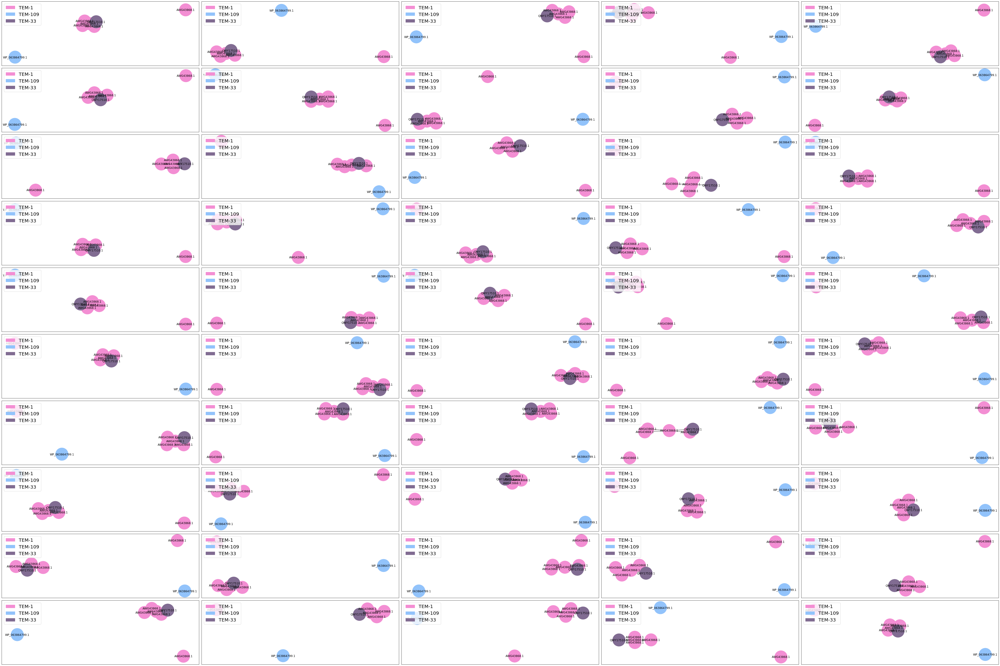

In [23]:
# Example usage
max_mismatches = 1
distance_matrix = build_distance_matrix(nucleotide_sequence_cluserdf, max_mismatches)

# Define a dictionary to map names to colors and node labels
names = nucleotide_sequence_cluserdf['name'].unique()
name_color_map = {name: random_color() for name in names}
name_label_map = {name: seq_id for name, seq_id in zip(nucleotide_sequence_cluserdf['name'], nucleotide_sequence_cluser_clear['protein_sequence_id'])}

# Get sequence names and corresponding colors
colors = [name_color_map[name] for name in nucleotide_sequence_cluserdf['name']]

# Create directed graph and add edges based on distance matrix
G = nx.Graph()
for i, name in enumerate(nucleotide_sequence_cluserdf['name']):
    G.add_node(i, color=name_color_map[name])

for i in range(len(nucleotide_sequence_cluserdf)):
    for j in range(i+1, len(nucleotide_sequence_cluserdf)):  # Modified loop to only add edges once
        weight = distance_matrix[i][j]
        if weight > 0:
            G.add_edge(i, j, weight=weight)

# Set figure size
plt.figure(figsize=(60, 40))

# Define the range of seed values
seed_range = range(51, 101)

# Loop through the range of seeds and create plots
for i, seed in enumerate(seed_range):
    # Visualize graph
    pos = nx.spring_layout(G, seed=seed, k=0.15, iterations=50, scale=1)
    plt.subplot(10, 5, i+1)
    nx.draw_networkx_nodes(G, pos, node_color=colors, node_size=3000)
    nx.draw_networkx_edges(G, pos, width=1, alpha=1)

    # Draw node labels as sequence ids
    labels = {i: name_label_map[nucleotide_sequence_cluserdf.iloc[i]['name']] for i in range(len(nucleotide_sequence_cluserdf))}
    nx.draw_networkx_labels(G, pos, labels)

    # Create legend table of color and name
    from matplotlib.patches import Patch
    legend_elements = [Patch(facecolor=color, label=name) for name, color in name_color_map.items()]
    plt.legend(handles=legend_elements, loc='upper left', fontsize=20)

    #plt.title("Seed: {}".format(seed), fontsize=20)

plt.tight_layout()
plt.show()
